# Motion prediction applied to self-driving vehicles

## 1. Competition goal and introduction

Self-driving cars: where are we in 2020? A small video intro:

In [1]:
# a brief explanation is found in this video
from IPython.display import HTML


HTML('<center><iframe  width="850" height="450" src="https://www.youtube.com/watch?v=EzylsrXtkxI" frameborder="0" allow="accelerometer; autoplay; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe></center>')


The goal for this competition is then to predict the motion of extraneous vehicles, people, animals (called "agents").
Full details about the dateset can be found on this academic paper https://arxiv.org/pdf/2006.14480.pdf
In section 2 the most important concept will be introduced. 
In section 3 a predicting model will be proposed.

## 2. Import libraries and  explore data

Before importing/installing libraries I added the following datasets: kaggle-l5kit, lyft-config-files, lyft-resnet18-baseline

### 2.1 basic libraries and l5kit

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import scipy as sp

import gc
import os
from pathlib import Path
import random
import sys
import yaml
from tqdm.notebook import tqdm





In [3]:
!pip install --no-index -f ../input/kaggle-l5kit pip==20.2.2 >/dev/nul
!pip install --no-index -f ../input/kaggle-l5kit -U l5kit > /dev/nul

ERROR: After October 2020 you may experience errors when installing or updating packages. This is because pip will change the way that it resolves dependency conflicts.

We recommend you use --use-feature=2020-resolver to test your packages with the new resolver before it becomes the default.

tensorflow-metadata 0.23.0 requires absl-py<0.9,>=0.7, but you'll have absl-py 0.10.0 which is incompatible.


In [4]:

## =====================================================================================
## This is a temporarly fix for the freezing and the cuda issues. You can add this
## utility script instead of kaggle_l5kit until Kaggle resolve these issues.
## 
## You will be able to train and submit your results, but not all the functionality of
## l5kit will work properly.

## More details here:
## https://www.kaggle.com/c/lyft-motion-prediction-autonomous-vehicles/discussion/177125


## this script transports l5kit and dependencies


import l5kit
print ('l5kit imported')
print("l5kit version:", l5kit.__version__)

l5kit imported
l5kit version: 1.0.6


In [5]:
!pip install efficientnet_pytorch

  Created wheel for efficientnet-pytorch: filename=efficientnet_pytorch-0.7.0-py3-none-any.whl size=16035 sha256=bc666e061d753ab52aab8f876ed8da5d16708cfe7456fb55d848a4f618fe53d4
  Stored in directory: /root/.cache/pip/wheels/b7/cc/0d/41d384b0071c6f46e542aded5f8571700ace4f1eb3f1591c29
Successfully built efficientnet-pytorch
You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [6]:
from l5kit.configs import load_config_data
from l5kit.data import LocalDataManager, ChunkedDataset
from l5kit.data import PERCEPTION_LABELS
from l5kit.dataset import AgentDataset, EgoDataset
from l5kit.rasterization import build_rasterizer
from itertools import islice
from typing import Dict


import torch
from torch import nn, optim


from efficientnet_pytorch import model as enet

from l5kit.evaluation.csv_utils import write_pred_csv
from l5kit.evaluation import compute_metrics_csv, read_gt_csv, create_chopped_dataset
from l5kit.evaluation.chop_dataset import MIN_FUTURE_STEPS
from l5kit.evaluation.metrics import neg_multi_log_likelihood, time_displace
from l5kit.geometry import transform_points
from l5kit.visualization import PREDICTED_POINTS_COLOR, TARGET_POINTS_COLOR, draw_trajectory


from l5kit.configs import load_config_data


from tqdm import tqdm
from collections import Counter

from prettytable import PrettyTable


from IPython.display import display, clear_output
from IPython.display import HTML

import PIL
import matplotlib.pyplot as plt
from matplotlib import animation, rc
rc('animation', html='jshtml')




In [7]:


# --- plotly ---
from plotly import tools, subplots
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates.default = "plotly_dark"

# --- models ---
from sklearn import preprocessing
from sklearn.model_selection import KFold

from torch import nn
from typing import Dict
from pathlib import Path



from torch import nn, optim
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Subset




### 2.2 Data import

The dataset consists of 170,000 scenes capturing the environment around the autonomous vehicle. Each scene encodes the state of the vehicle’s surroundings at a given point in time. 

In [8]:
l5kit_data_folder = "../input/lyft-motion-prediction-autonomous-vehicles"
os.environ["L5KIT_DATA_FOLDER"] = l5kit_data_folder


In [9]:
IMG_SIZE = 224
# --- Lyft configs ---
cfg = {
          'model_params': {'model_architecture': 'efficientnet-b6',
          'history_num_frames': 0,
          'history_step_size': 1,
          'history_delta_time': 0.1,
          'future_num_frames': 50,
          'future_step_size': 1,
          'future_delta_time': 0.1},

        'raster_params': {'raster_size': [IMG_SIZE, IMG_SIZE],
          'pixel_size': [0.5, 0.5],
          'ego_center': [0.25, 0.5],
          'map_type': 'py_semantic',
          'satellite_map_key': 'aerial_map/aerial_map.png',
          'semantic_map_key': 'semantic_map/semantic_map.pb',
          'dataset_meta_key': 'meta.json',
          'filter_agents_threshold': 0.5},

        'train_data_loader': {'key': 'scenes/train.zarr',
          'batch_size': 8,
          'shuffle': True,
          'num_workers': 4},

        "valid_data_loader":{"key": "scenes/validation.zarr",
                            "batch_size": 8,
                            "shuffle": False,
                            "num_workers": 4},
    
        "sample_data_loader": {
        'key': 'scenes/sample.zarr',
        'batch_size': 12,
        'shuffle': False,
        'num_workers': 16},
         
        "test_data_loader":{
        'key': "scenes/test.zarr",
        'batch_size': 8,
        'shuffle': False,
        'num_workers': 4},

    
        'train_params': {'checkpoint_every_n_steps': 100,
          'max_num_steps':500,
          'eval_every_n_steps': 10}
        }
print(cfg)

{'model_params': {'model_architecture': 'efficientnet-b6', 'history_num_frames': 0, 'history_step_size': 1, 'history_delta_time': 0.1, 'future_num_frames': 50, 'future_step_size': 1, 'future_delta_time': 0.1}, 'raster_params': {'raster_size': [224, 224], 'pixel_size': [0.5, 0.5], 'ego_center': [0.25, 0.5], 'map_type': 'py_semantic', 'satellite_map_key': 'aerial_map/aerial_map.png', 'semantic_map_key': 'semantic_map/semantic_map.pb', 'dataset_meta_key': 'meta.json', 'filter_agents_threshold': 0.5}, 'train_data_loader': {'key': 'scenes/train.zarr', 'batch_size': 8, 'shuffle': True, 'num_workers': 4}, 'valid_data_loader': {'key': 'scenes/validation.zarr', 'batch_size': 8, 'shuffle': False, 'num_workers': 4}, 'sample_data_loader': {'key': 'scenes/sample.zarr', 'batch_size': 12, 'shuffle': False, 'num_workers': 16}, 'test_data_loader': {'key': 'scenes/test.zarr', 'batch_size': 8, 'shuffle': False, 'num_workers': 4}, 'train_params': {'checkpoint_every_n_steps': 100, 'max_num_steps': 500, 'ev

### 2.3 Data exploration

Credits to https://www.kaggle.com/nxrprime/lyft-understanding-the-data-baseline-on-tpus

Input data files are available in the read-only "../input/" directory.
The dataset is structured as follows:
- aerial_map
- scenes
- semantic_map

Aerial map subfolder contains images. Scenes subfolder contains information about foreing street objects classified in zarr files as following

- sample.zarr
- test.zarr
- train.zarr
- validate.zarr

For who never heard about "zarr" (for Italians, nothing to do with "zarro"):

"Zarr" provides classes and functions for working with N-dimensional arrays that behave like NumPy arrays but whose data is divided into chunks and each chunk is compressed.
Useful for handling big data.
More info at http://alimanfoo.github.io/2016/04/14/to-hdf5-and-beyond.html

The dataset consists of frames and agent states. A frame is a snapshot in time which consists of ego pose, time, and multiple agent states. Each agent state describes the position, orientation, bounds, and type.

sample.zarr data is used for visualization, train.zarr / validate.zarr / test.zarr are those needed for actual model training/validation/prediction.
We're building a LocalDataManager object. This will resolve relative paths from the config using the L5KIT_DATA_FOLDER env variable that was set above.

In [10]:
dm = LocalDataManager()
dataset_path = dm.require(cfg["sample_data_loader"]["key"]) # for the EDA we use samples dataset. Smaller and RAM-ready
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)



+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


#### Instead of working with raw data, L5Kit provides PyTorch ready datasets. It's much easier to use this wrapped dataset class to access data.

2 dataset class is implemented.

    EgoDataset: this dataset iterates over the AV (Autonomous Vehicle) annotations
    AgentDataset: this dataset iterates over other agents annotations

Let's see each class in detail. What kind of attributes/methods they have? What kind of data structure for each attributes?

As written in Class diagram, both classes are instantiated by:

    cfg: configuration file
    ChunkedDataset: Internal data class which holds 4 raw data scenes, frames, agents and tl_faces (described later).
    rasterizer: Rasterizer converts raw data into image.


### 2.4 Data examples

#### Objects in our maps, defined as "agents"

In [11]:
agents = zarr_dataset.agents
probabilities = agents["label_probabilities"]
labels_indexes = np.argmax(probabilities, axis=1)
counts = []
for idx_label, label in enumerate(PERCEPTION_LABELS):
    counts.append(np.sum(labels_indexes == idx_label))
    
table = PrettyTable(field_names=["label", "counts"])
for count, label in zip(counts, PERCEPTION_LABELS):
    table.add_row([label, count])
print(table)

+------------------------------------+---------+
|               label                |  counts |
+------------------------------------+---------+
|      PERCEPTION_LABEL_NOT_SET      |    0    |
|      PERCEPTION_LABEL_UNKNOWN      | 1324481 |
|     PERCEPTION_LABEL_DONTCARE      |    0    |
|        PERCEPTION_LABEL_CAR        |  519385 |
|        PERCEPTION_LABEL_VAN        |    0    |
|       PERCEPTION_LABEL_TRAM        |    0    |
|        PERCEPTION_LABEL_BUS        |    0    |
|       PERCEPTION_LABEL_TRUCK       |    0    |
| PERCEPTION_LABEL_EMERGENCY_VEHICLE |    0    |
|   PERCEPTION_LABEL_OTHER_VEHICLE   |    0    |
|      PERCEPTION_LABEL_BICYCLE      |    0    |
|    PERCEPTION_LABEL_MOTORCYCLE     |    0    |
|      PERCEPTION_LABEL_CYCLIST      |   6688  |
|   PERCEPTION_LABEL_MOTORCYCLIST    |    0    |
|    PERCEPTION_LABEL_PEDESTRIAN     |  43182  |
|      PERCEPTION_LABEL_ANIMAL       |    0    |
|     AVRESEARCH_LABEL_DONTCARE      |    0    |
+-------------------

#### Aerial map showing the "ego" vehicle trajectory and animation including agents 

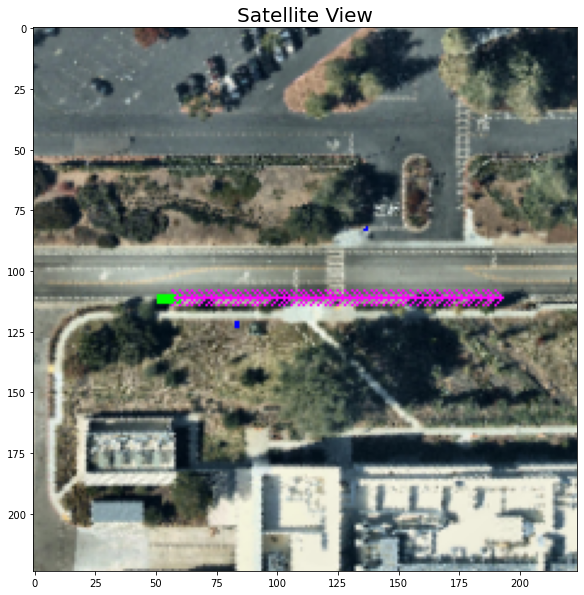

In [12]:
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
data = dataset[80]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
figsize = plt.subplots(figsize = (10,10))
plt.title('Satellite View',fontsize=20)
plt.imshow(im[::-1])
plt.show()


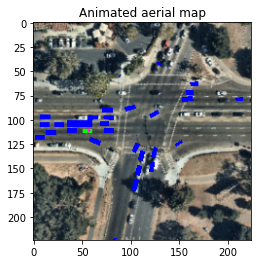

In [13]:
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])
 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    plt.title('Animated aerial map')
    return animation.FuncAnimation(fig, animate, frames=len(images), interval=60)

cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
anim = animate_solution(images)
HTML(anim.to_jshtml())


#### Semantic map, animated


Meaning of color in semantic map?

Looking the code, I see that

    default lane color is "light yellow" (255, 217, 82). code
    green, yellow, red color on lane is to show trafic light condition. code
    orange box represents crosswalk. code

Please refer below animation to verify it.


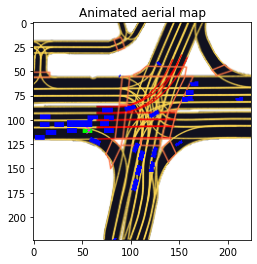

In [14]:
cfg["raster_params"]["map_type"] = "py_semantic"
# Rasterizer
rast = build_rasterizer(cfg, dm)

dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
    
anim = animate_solution(images)
HTML(anim.to_jshtml())

## 3. Predicting model

MODEL_NAME: It can be one of-

    "efficientnet-b0"
    "efficientnet-b1"
    "efficientnet-b2"
    "efficientnet-b3"
    "efficientnet-b4"
    "efficientnet-b5"
    "efficientnet-b6"
    "efficientnet-b7"

IMG_SIZE: for b6 is preferably 528, but cannot fit inside the GPU RAM and I use 224 instead



In [15]:
WEIGHT_FILE = None # Model state_dict path of previously trained model
MODEL_NAME = "efficientnet-b6"
IMG_SIZE = IMG_SIZE # stated above, together with cfg
VALIDATION = True # A hyperparameter you could use to toggle for validating the model

In [16]:
# UTILITY FUNCTIONS
def build_model(cfg) -> torch.nn.Module:
    """Creates an instance of the pretrained model with custom input and output"""
    model = enet.EfficientNet.from_name(MODEL_NAME)
    
    num_history_channels = (cfg["model_params"]["history_num_frames"] + 1) * 2
    num_in_channels = 3 + num_history_channels
    num_targets = 2*cfg["model_params"]["future_num_frames"]
    
    model._conv_stem = nn.Conv2d(
        num_in_channels,
        model._conv_stem.out_channels,
        kernel_size=model._conv_stem.kernel_size,
        stride=model._conv_stem.stride,
        padding=model._conv_stem.padding,
        bias=False
    )
    
    model._fc = nn.Linear(in_features=model._fc.in_features, out_features=num_targets)
    return model

def forward(data, model, device, criterion):
    """Forward Propogation function"""
    inputs = data["image"].to(device)
    target_availabilities = data["target_availabilities"].unsqueeze(-1).to(device)
    targets = data["target_positions"].to(device)
    
    outputs = model(inputs)
    outputs = outputs.reshape(targets.shape)
    loss = criterion(outputs, targets)
    
    loss = loss * target_availabilities
    loss = loss.mean()
    loss = torch.sqrt(loss) # Using smoothL1 loss
    return loss, outputs


def get_dataloader(config, zarr_data, map_type="py_semantic"):
    """Creates DataLoader instance for the given dataset."""
    cfg["raster_params"]["map_type"] = map_type
    rasterizer = build_rasterizer(cfg, dm)
    chunk_data = ChunkedDataset(zarr_data).open()
    agent_data = AgentDataset(cfg, chunk_data, rasterizer)
    dataloader = DataLoader(agent_data, 
                            batch_size=config["batch_size"],
                            num_workers=config["num_workers"],
                            shuffle=config["shuffle"]
                           )
    return dataloader

def train(opt=None, criterion=None, lrate=1e-4):
        """Function for training the model"""
        print("Building Model...")
        device=torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
        model = build_model(cfg).to(device)
        optimizer = optim.Adam(model.parameters(), lr=lrate) if opt is None else opt
        criterion = nn.MSELoss(reduction="none")
        
        if WEIGHT_FILE is not None:
            state_dict = torch.load(WEIGHT_FILE, map_location=device)
            model.load_state_dict(state_dict)
        
        print("Loading training and validation data using Dataloader...")
        train_dataloader = get_dataloader(cfg["train_data_loader"], dm.require("scenes/train.zarr"))
        train_iter = iter(train_dataloader)
    
        if VALIDATION:
            valid_dataloader = get_dataloader(cfg["valid_data_loader"], dm.require("scenes/validate.zarr"))
            val_iter = iter(valid_dataloader) 
        
        print("Training...")
        losses = []
        losses_mean = []
        val_losses = []
        val_losses_mean = []
        progress = tqdm(range(cfg["train_params"]["max_num_steps"]))
        
        for i in progress:
            try:
                data = next(train_iter)
            except StopIteration:
                train_iter = iter(train_dataloader)
                data = next(train_iter)
                    
            model.train()
            torch.set_grad_enabled(True)
                    
            loss, _ = forward(data, model, device, criterion)
                    
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # Validation
            if VALIDATION:
                with torch.no_grad():
                    try:
                        val_data = next(val_iter)
                    except StopIteration:
                        val_iter = iter(val_dataloader)
                        val_data = next(val_iter)

                    val_loss, _  = forward(val_data, model, device, criterion)
                    val_losses.append(val_loss.item())
                    val_losses_mean.append(np.mean(val_losses))
                    
                desc = f" Loss: {round(loss.item(), 4)} Validation Loss: {round(val_loss.item(), 4)}"
            else:
                desc = f" Loss: {round(loss.item(), 4)}"
                
            if len(losses)>0 and loss < min(losses):
                print(f"Loss improved from {min(losses)} to {loss}")
                
                
            losses.append(loss.item())
            losses_mean.append(np.mean(losses))
            progress.set_description(desc)
            
        return losses_mean, val_losses_mean, model

In [17]:

losses, val_losses, model = train()


Building Model...
Loading training and validation data using Dataloader...


  0%|          | 0/500 [00:00<?, ?it/s]

Training...


 Loss: 1.766 Validation Loss: 1.5611:   2%|▏         | 8/500 [00:07<06:33,  1.25it/s]

Loss improved from 8.060224533081055 to 1.7660226821899414


 Loss: 0.5694 Validation Loss: 5.5052:  10%|▉         | 48/500 [00:34<04:57,  1.52it/s]

Loss improved from 1.7660226821899414 to 0.5694345235824585


 Loss: 0.4013 Validation Loss: 13.6643:  12%|█▏        | 58/500 [00:42<05:30,  1.34it/s]

Loss improved from 0.5694345235824585 to 0.40125778317451477


 Loss: 0.3498 Validation Loss: 16.9543:  66%|██████▌   | 330/500 [03:51<01:51,  1.53it/s]

Loss improved from 0.40125778317451477 to 0.34978529810905457


 Loss: 0.3104 Validation Loss: 11.2487:  89%|████████▉ | 447/500 [05:14<00:48,  1.10it/s]

Loss improved from 0.34978529810905457 to 0.3104393184185028


 Loss: 11.7962 Validation Loss: 11.3858: 100%|██████████| 500/500 [05:52<00:00,  1.42it/s]


In [18]:
print("Saving the model...")
torch.save(model.state_dict(), "lyft_model.pth")

Saving the model...


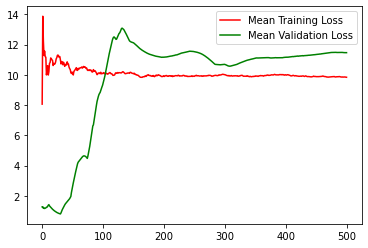

In [19]:
# Training Analysis
plt.plot(losses, c="red", label="Mean Training Loss")
plt.plot(val_losses, c="green", label="Mean Validation Loss")
plt.legend()
plt.show()


In [20]:
PATH_TO_DATA = '/kaggle/input/lyft-motion-prediction-autonomous-vehicles/'

test_cfg = cfg["test_data_loader"]

# Rasterizer
rasterizer = build_rasterizer(cfg, dm)

# Test dataset/dataloader
test_zarr = ChunkedDataset(dm.require(test_cfg["key"])).open()
test_mask = np.load(f"{PATH_TO_DATA}/scenes/mask.npz")["arr_0"]
test_dataset = AgentDataset(cfg, test_zarr, rasterizer, agents_mask=test_mask)
test_dataloader = DataLoader(test_dataset,
                             shuffle=test_cfg["shuffle"],
                             batch_size=test_cfg["batch_size"],
                             num_workers=test_cfg["num_workers"])


print(test_dataset)



warning, you're running with a custom agents_mask
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|   11314    |  1131400   |  88594921  |      31.43      |        100.00        |        78.31         |        10.00         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [21]:


def submission_result(model, dataset):
    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
    model.eval()
    model = model.to(device)
    
    criterion = nn.MSELoss(reduction="none")
    
    with torch.no_grad():
        
        # store information for evaluation
        future_coords_offsets_pd = []
        timestamps = []
        agent_ids = []
        for idx, data in enumerate(tqdm(test_dataloader)):
#             if idx > 100: break
            inputs = torch.tensor(data["image"], device=device)
            target_availabilities = torch.tensor(data["target_availabilities"], device=device
            ).unsqueeze(-1)
            targets = torch.tensor(data["target_positions"], device=device)
            outputs = model(inputs).reshape(targets.shape)
            outputs = outputs.cpu().numpy().copy()
            future_coords_offsets_pd.append(outputs)
            timestamps.append(data["timestamp"].numpy().copy())
            agent_ids.append(data["track_id"].numpy().copy())


    write_pred_csv(
        "submission.csv",
        timestamps=np.concatenate(timestamps),
        track_ids=np.concatenate(agent_ids),
        coords=np.concatenate(future_coords_offsets_pd),
    )


In [22]:

# Test dataset/dataloader


submission_result(model, test_dataset)

  0%|          | 0/8891 [00:00<?, ?it/s]/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:16: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:17: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:19: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).

100%|██████████| 8891/8891 [39:56<00:00,  3.71it/s]
